# AutoLevel

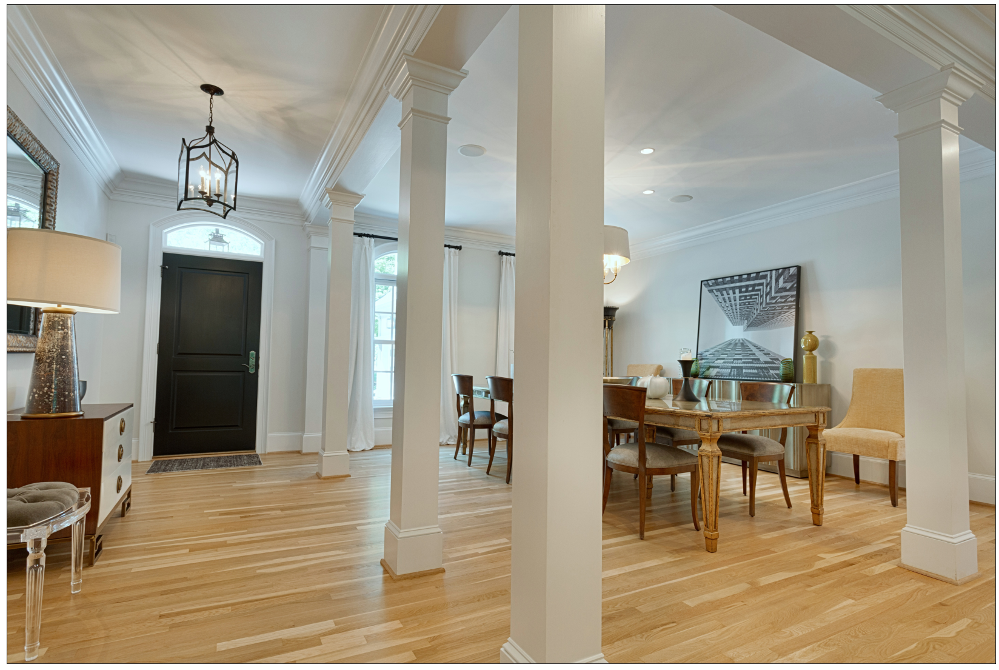

In [82]:
from matplotlib import pyplot as plt
from PIL import Image

# Load image
image = Image.open("../media/71.jpg")

# Plot
plt.figure(figsize=(30, 20))
plt.imshow(image)
plt.xticks([])
plt.yticks([])
plt.show()

We detect lines in the image.

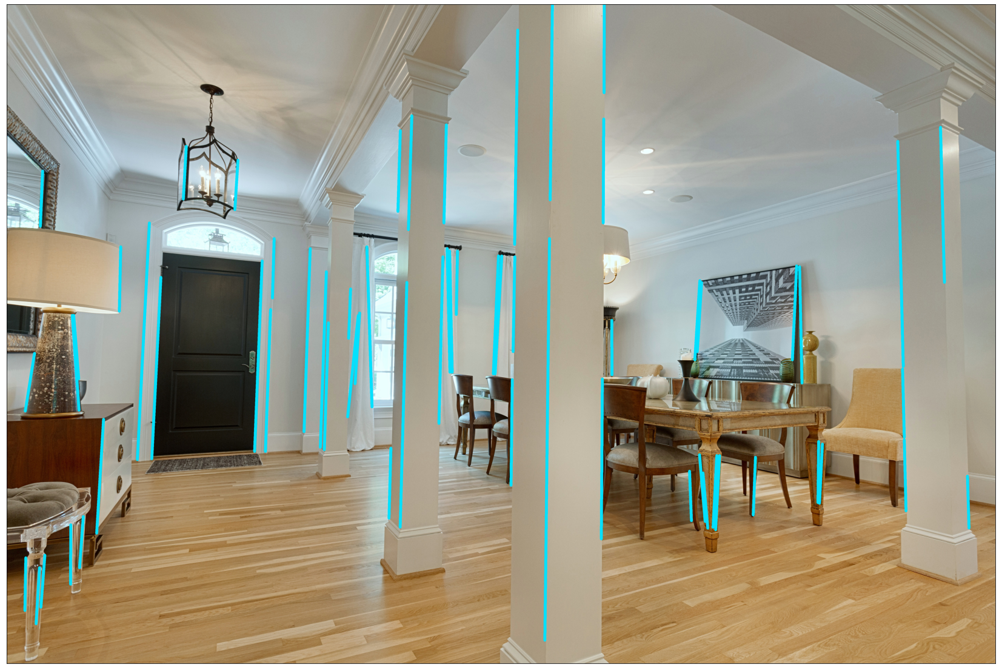

In [83]:
from cv2 import line
from lsd import line_segment_detector
from numpy import abs, arctan2, asarray, pi, rad2deg

# Detect lines
MIN_LENGTH = 0.05
min_length = image.width * MIN_LENGTH
scale = 1200. / image.width
lines = line_segment_detector(asarray(image), scale=scale, angle_tolerance=18.)
lines = lines[lines[:,6] > min_length]

# Extract vertical lines
MAX_ANGLE = 12.
vertical_line_mask = abs(rad2deg(arctan2(lines[:,3] - lines[:,1], lines[:,2] - lines[:,0]) % pi) - 90.) < MAX_ANGLE
vertical_lines = lines[vertical_line_mask]

# Visualize
line_image = asarray(image)
for x1, y1, x2, y2 in vertical_lines[:,:4].astype(int):
    line(line_image, (x1, y1), (x2, y2), (0, 225, 255), 16)

# Plot
plt.figure(figsize=(30, 20))
plt.imshow(line_image)
plt.xticks([])
plt.yticks([])
plt.show()

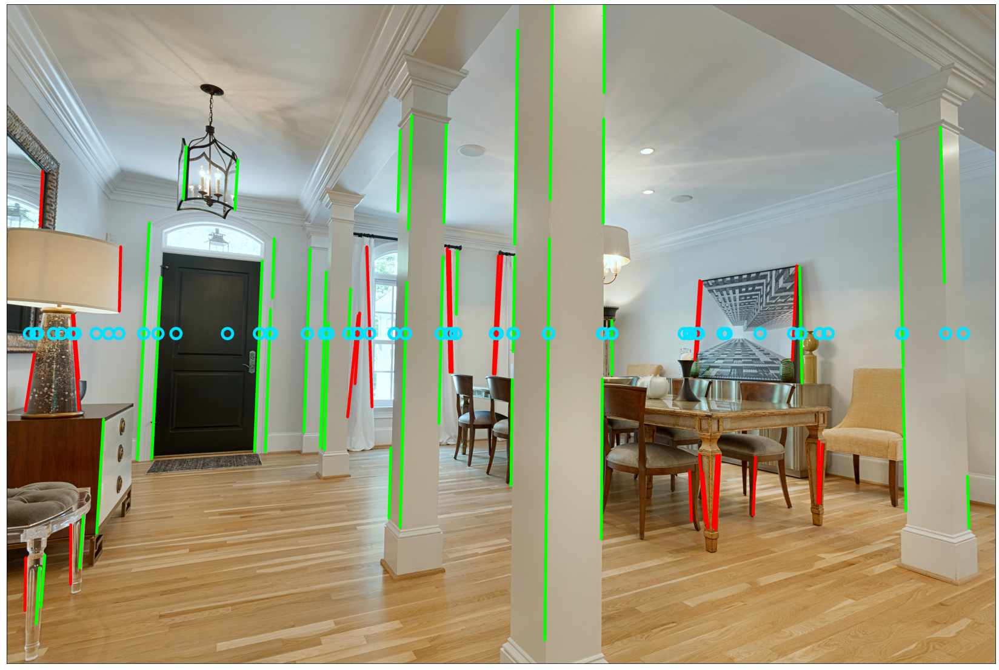

In [135]:
from cv2 import circle
from numpy import array, tensordot, zeros_like

# Compute intersection of lines with image midpoint
mid_line = array([ 0., image.height / 2., image.width, image.height / 2. ])[None,:] # (1,4)

d_a = vertical_lines[:,2:4] - vertical_lines[:,0:2]
d_b = mid_line[:,2:4] - mid_line[:,0:2]
d_p = vertical_lines[:,0:2] - mid_line[:,0:2]

d_a_perp = zeros_like(d_a)
d_a_perp[:,0] = -d_a[:,1]
d_a_perp[:,1] = d_a[:,0]
proj = (d_a_perp * d_p).sum(axis=1) / (d_a_perp * d_b).sum(axis=1)
intersection = proj[:,None] * d_b + mid_line[:,0:2]

# Visualize
for x, y in intersection.astype(int):
    circle(line_image, (x, y), 30, (0, 225, 255), 16)

# Plot
plt.figure(figsize=(30, 20))
plt.imshow(line_image)
plt.xticks([])
plt.yticks([])
plt.show()

We plot the distribution of angles against relative $x$-position.

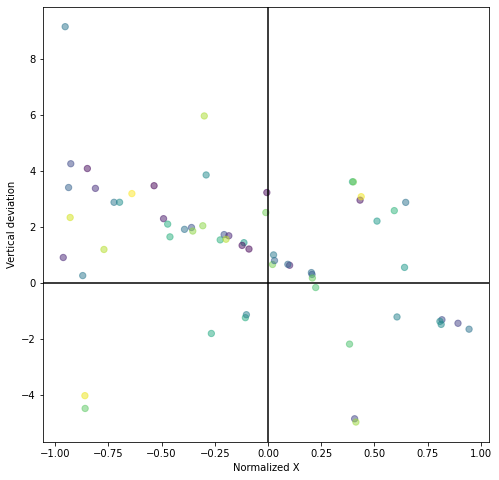

In [84]:
from numpy.random import rand

# Compute line x vs. theta
vertical_lines_theta = rad2deg(arctan2(vertical_lines[:,3] - vertical_lines[:,1], vertical_lines[:,2] - vertical_lines[:,0]) % pi) - 90.
vertical_lines_x = 2. * ((vertical_lines[:,2] + vertical_lines[:,0]) / 2.) / image.width - 1.

# Plot
plt.figure(figsize=(8, 8))
plt.scatter(vertical_lines_x, vertical_lines_theta, s=40, c=rand(vertical_lines_x.shape[0]), alpha=0.5)
plt.axhline(0., color="black")
plt.axvline(0., color="black")
plt.xlabel("Normalized X")
plt.ylabel("Vertical deviation")
plt.show()

Next, we filter outliers. Here, we use RANSAC, but ideally we want a fully-deterministic outlier detection method.

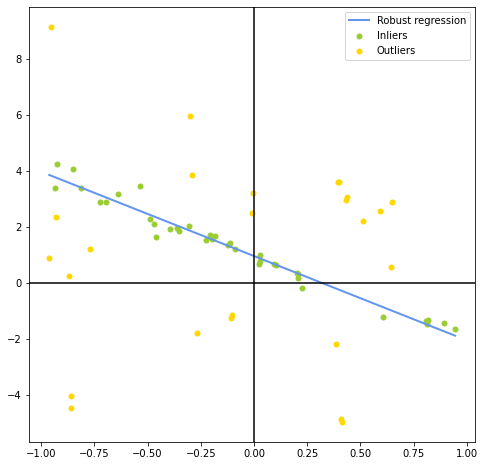

In [85]:
from numpy import linspace, logical_not
from sklearn.linear_model import RANSACRegressor

# Regress with RANSAC
ransac = RANSACRegressor(max_trials=1000)
ransac.fit(vertical_lines_x.reshape(-1, 1), vertical_lines_theta)
inlier_mask = ransac.inlier_mask_
outlier_mask = logical_not(inlier_mask)

# Predict over full range
line_X = linspace(vertical_lines_x.min(), vertical_lines_x.max())[:, None]
line_T = ransac.predict(line_X)

# Plot
plt.figure(figsize=(8, 8))
plt.scatter(vertical_lines_x[inlier_mask], vertical_lines_theta[inlier_mask], s=100, color="yellowgreen", marker=".", label="Inliers")
plt.scatter(vertical_lines_x[outlier_mask], vertical_lines_theta[outlier_mask], s=100, color="gold", marker=".", label="Outliers")
plt.plot(line_X, line_T, color="cornflowerblue", linewidth=2, label="Robust regression")
plt.axhline(0., color="black")
plt.axvline(0., color="black")
plt.legend()
plt.show()

We visualize the filtered lines:

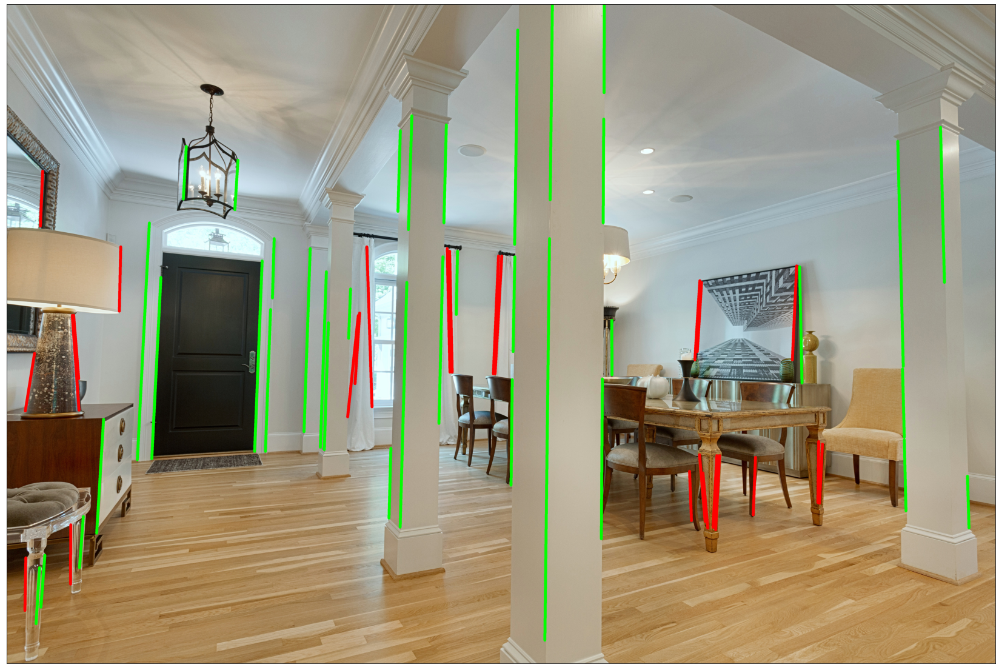

In [86]:
# Draw
line_image = asarray(image)
for x1, y1, x2, y2 in vertical_lines[inlier_mask,:4].astype(int):
    line(line_image, (x1, y1), (x2, y2), (0, 255, 0), 16)
for x1, y1, x2, y2 in vertical_lines[outlier_mask,:4].astype(int):
    line(line_image, (x1, y1), (x2, y2), (255, 0, 0), 16)

# Plot
plt.figure(figsize=(30, 20))
plt.imshow(line_image)
plt.xticks([])
plt.yticks([])
plt.show()

Now, we can auto-level the image by rotating the image such that $\theta = 0$ at $x = 0$.

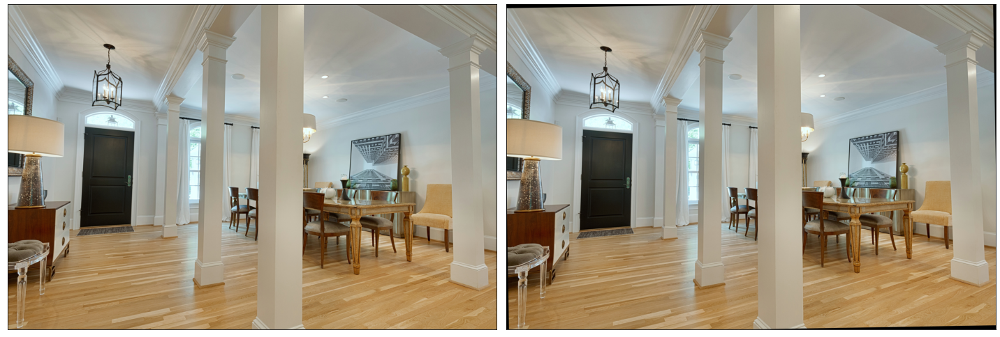

In [87]:
from cv2 import getRotationMatrix2D, warpAffine, INTER_LINEAR

# Rotate image
image_center = (image.width // 2, image.height // 2)
correction_angle = ransac.estimator_.intercept_
M = getRotationMatrix2D(image_center, correction_angle, 1.0)
leveled = warpAffine(asarray(image), M, image.size, flags=INTER_LINEAR)

# Plot
plt.figure(figsize=(20, 10))
plt.subplot(1, 2, 1)
plt.imshow(image)
plt.xticks([])
plt.yticks([])
plt.subplot(1, 2, 2)
plt.imshow(leveled)
plt.xticks([])
plt.yticks([])
plt.tight_layout()
plt.show()

Now, we plot the distribution of line angles in the rotated image to confirm our model:

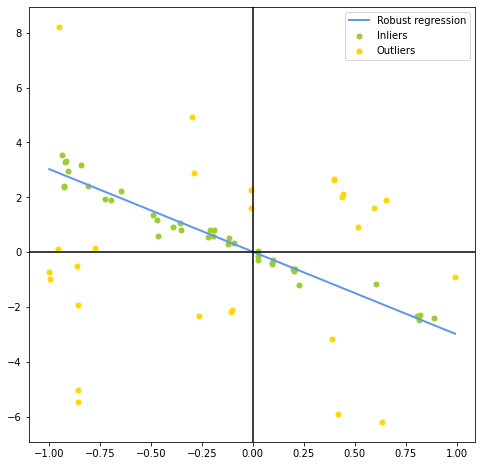

In [88]:
# Extract vertical lines
leveled_lines = line_segment_detector(leveled, scale=scale, angle_tolerance=18.)
leveled_lines = leveled_lines[leveled_lines[:,6] > min_length]
vertical_line_mask = abs(rad2deg(arctan2(leveled_lines[:,3] - leveled_lines[:,1], leveled_lines[:,2] - leveled_lines[:,0]) % pi) - 90.) < MAX_ANGLE
leveled_lines = leveled_lines[vertical_line_mask]

# Compute line x vs. theta
leveled_lines_theta = rad2deg(arctan2(leveled_lines[:,3] - leveled_lines[:,1], leveled_lines[:,2] - leveled_lines[:,0]) % pi) - 90.
leveled_lines_x = 2. * ((leveled_lines[:,2] + leveled_lines[:,0]) / 2.) / image.width - 1.
ransac.fit(leveled_lines_x.reshape(-1, 1), leveled_lines_theta)
leveled_line_X = linspace(leveled_lines_x.min(), leveled_lines_x.max())[:, None]
leveled_line_T = ransac.predict(leveled_line_X)

# Plot
plt.figure(figsize=(8, 8))
plt.scatter(leveled_lines_x[ransac.inlier_mask_], leveled_lines_theta[ransac.inlier_mask_], s=100, color="yellowgreen", marker=".", label="Inliers")
plt.scatter(leveled_lines_x[~ransac.inlier_mask_], leveled_lines_theta[~ransac.inlier_mask_], s=100, color="gold", marker=".", label="Outliers")
plt.plot(leveled_line_X, leveled_line_T, color="cornflowerblue", linewidth=2, label="Robust regression")
plt.axhline(0., color="black")
plt.axvline(0., color="black")
plt.legend()
plt.show()